<a href="https://colab.research.google.com/github/inachenyx/SpeechSNN/blob/main/SR_Latency_Encoding.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import io
import numpy as np
import pandas as pd
import torch
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

### Upload data from local files

In [2]:
from google.colab import files
uploaded = files.upload()

Saving ae.train to ae.train
Saving ae.test to ae.test
Saving size_ae.train to size_ae.train
Saving size_ae.test to size_ae.test


In [3]:
# List uploaded files
os.listdir()

['.config',
 'ae.test',
 'ae.train',
 'size_ae.test',
 'size_ae.train',
 'sample_data']

### Read original data (has type bytes)

In [4]:
with open("ae.train", "rb") as f:
    train_bytes = f.read()

with open("ae.test", "rb") as f:
    test_bytes = f.read()

with open("size_ae.train", "rb") as f:
    train_counts_bytes = f.read()

with open("size_ae.test", "rb") as f:
    test_counts_bytes = f.read()

print(train_bytes[:100]) # bytes containing space-separated float values
print(type(train_bytes)) # <class 'bytes'> raw bytes
print(test_bytes[:100])
print(type(test_bytes))
print(train_counts_bytes)
print(type(train_counts_bytes))
print(test_counts_bytes)
print(type(test_counts_bytes))

b'1.860936 -0.207383 0.261557 -0.214562 -0.171253 -0.118167 -0.277557 0.025668 0.126701 -0.306756 -0.2'
<class 'bytes'>
b'1.635533 0.024848 0.432087 -0.361914 -0.074776 -0.693481 -0.229621 0.261503 -0.089421 -0.020431 -0.0'
<class 'bytes'>
b'30 30 30 30 30 30 30 30 30\n'
<class 'bytes'>
b'31 35 88 44 29 24 40 50 29 \n'
<class 'bytes'>


### Get train_counts, test counts

In [5]:
def byte_to_list(byte_data):
  """Decode label counts from raw bytes data to a list of integers

    Args:
        byte_data (bytes): data read from size_ae.train, size_ae.test

    Returns:
        List[int]: the decoded label counts
    """
  text = byte_data.decode("utf-8")
  list_str = text.strip().split()
  list_fl = [int(x) for x in list_str]
  # list_fl = list(map(int, list_str))
  return list_fl

train_counts = byte_to_list(train_counts_bytes)
test_counts = byte_to_list(test_counts_bytes)
print(train_counts)
print(test_counts)

[30, 30, 30, 30, 30, 30, 30, 30, 30]
[31, 35, 88, 44, 29, 24, 40, 50, 29]


### Get latency encoded blocks (to arrays)

In [6]:
def prepare_spike_data(byte_data, label_counts):
    """Parses raw byte input from the UCI Japanese Vowels dataset and applies custom latency encoding
    to prepare spiking input data for use in spiking neural networks.

    This function performs the following steps for each utterance:
      1. Parses the raw byte data into individual (Ti, 12) analog feature matrices.
      2. Transposes to (12, Ti) and binarizes each matrix based on the average value within the block.
      3. Splits each matrix into T column vectors (12, 1) and computes their L2 norms.
      4. Scales norm values to a 0–50ms range to determine latency positions within 100ms intervals.
      5. Places each (12, 1) vector into a larger zero matrix of shape (12, Tmax * 100) at its latency-mapped time offset.
      6. Returns a NumPy array of shape (N, 12, Tmax * 100) containing spike-encoded matrices.

    Args:
        byte_data (bytes): Raw byte content from a `.train` or `.test` file in the UCI Japanese Vowels dataset.
        label_counts (List[int]): List where each element indicates the number of utterances for one speaker.

    Returns:
        np.ndarray: A NumPy array of shape (N, 12, Tmax * 100) representing latency-encoded spike inputs.
        np.ndarray: A NumPy array of shape (N,) with integer speaker labels (starting from 1).
        int: The total length of the time dimension after encoding, equal to Tmax * 100.

    Notes:
        - Tmax is the longest utterance duration (number of frames) across all speakers.
        - Each time step is expanded into a 100ms spike interval.
        - Latency encoding is based on the relative norm of spectral energy at each frame.

    Example:
        >>> with open('ae.train', 'rb') as f:
        ...     byte_data = f.read()
        >>> label_counts = [30, 30, 30, 30, 30, 30, 30, 30, 30]  # 9 speakers × 30 utterances
        >>> X_np, y_np, T_encoded = prepare_spike_data(byte_data, label_counts)
    """
    text = byte_data.decode("utf-8")
    blocks = [b.strip() for b in text.strip().split("\n\n") if b.strip()]

    data_blocks = []
    labels = []

    for speaker_id, count in enumerate(label_counts, start=1):
        for idx in range(count):
            lines = blocks[idx].splitlines()
            frame_data = [list(map(float, line.strip().split())) for line in lines] # shape (Ti, 12)
            data_blocks.append(np.array(frame_data))
            labels.append(speaker_id)

    latency_encoded_blocks = []
    Tmax = max([block.shape[0] for block in data_blocks])  # maximum time steps

    for block in data_blocks:
        block = block.T  # shape (12, T)
        avg = np.mean(block)
        binary_block = (block >= avg).astype(np.float32)  # binarized (12, T)

        T = binary_block.shape[1]
        columns = [binary_block[:, t].reshape(12, 1) for t in range(T)]

        norms = np.array([np.linalg.norm(col) for col in columns])
        min_norm, max_norm = norms.min(), norms.max()

        if max_norm - min_norm == 0:
            norm_scaled = np.zeros_like(norms)
        else:
            norm_scaled = ((norms - min_norm) / (max_norm - min_norm)) * 50.0
        norm_scaled = norm_scaled.astype(int)

        stim_length = Tmax * 100
        output_matrix = np.zeros((12, stim_length), dtype=np.float32)

        for i, col in enumerate(columns):
            t_offset = i * 100 + norm_scaled[i]
            if t_offset < stim_length:
                output_matrix[:, t_offset] = col.flatten()

        latency_encoded_blocks.append(output_matrix)

    data_array = np.stack(latency_encoded_blocks)  # shape: (N, 12, Tmax*100)
    label_array = np.array(labels, dtype=np.int64)

    return data_array, label_array, Tmax


In [7]:
X_train_np, y_train_np, train_T = prepare_spike_data(train_bytes, train_counts)
X_test_np, y_test_np, test_T = prepare_spike_data(test_bytes, test_counts)

print(X_train_np.shape)  # (270, 12, train_T*100)
print(y_train_np.shape)  # (270,)
print(X_test_np.shape)  # (370, 12, test_T*100)
print(y_test_np.shape)  # (370,)
print(train_T) # 26
print(test_T) # 29

(270, 12, 2600)
(270,)
(370, 12, 2900)
(370,)
26
29


In [13]:
def visualize_latency_encoded_block(X_np, block_idx=0, title=None):
    """
    Visualizes a latency-encoded spike matrix as a raster plot.

    Args:
        X_np (np.ndarray): Array of shape (N, 12, Tmax*100), where N is the number of samples.
        block_idx (int): Index of the block to visualize (default is 0).
        title (str, optional): Title for the plot.
    """
    block = X_np[block_idx]  # shape: (12, Tmax*100)

    fig, ax = plt.subplots(figsize=(15, 4))

    for ch in range(12):
        spike_times = np.where(block[ch] > 0)[0]  # spike positions in time
        ax.vlines(spike_times, ch + 0.5, ch + 1.5, color='black', linewidth=1)

    ax.set_ylim(0.5, 12.5)
    ax.set_yticks(np.arange(1, 13))
    ax.set_xlim(0, block.shape[1])
    ax.set_xticks(np.arange(0, block.shape[1] + 1, 100))
    ax.set_yticklabels([f'Ch {i}' for i in range(1, 13)])
    # ax.invert_yaxis()
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel('Electrode Channel')
    ax.set_title(title or f'Latency-Encoded Spike Raster (Block {block_idx})')
    ax.grid(True, axis='x', linestyle='--', alpha=0.3)
    # Custom horizontal gridlines between channels
    for y in np.arange(0.5, 12.5, 1.0):
        ax.axhline(y, linestyle='--', linewidth=0.5, alpha=0.3)

    plt.tight_layout()
    plt.show()

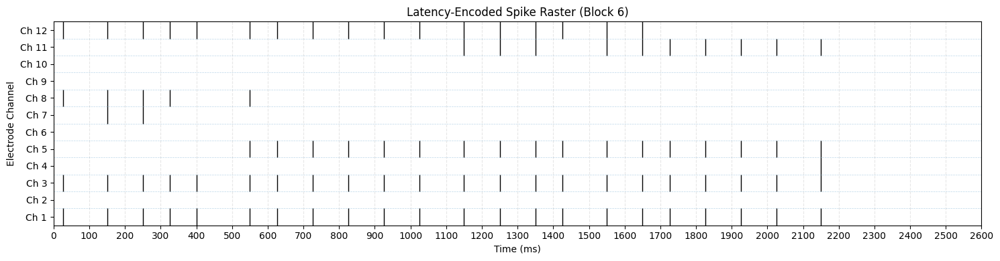

In [14]:
visualize_latency_encoded_block(X_train_np, block_idx=6)

In [16]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def animate_latency_encoded_blocks(X_np, interval=1000):
    """
    Animates a latency-encoded spike matrix over all blocks (samples).

    Args:
        X_np (np.ndarray): Array of shape (N, 12, Tmax*100), where N is the number of samples.
        interval (int): Delay between frames in milliseconds.

    Returns:
        FuncAnimation: Animation object for rendering or saving.
    """
    N, C, T = X_np.shape
    assert C == 12, f"Expected 12 channels, got {C}"

    cmap = plt.get_cmap('tab20')
    channel_colors = [cmap(i) for i in range(12)]  # Ensure 12 colors

    fig, ax = plt.subplots(figsize=(15, 5))

    def plot_block(block, frame_idx):
        ax.clear()

        for ch in range(12):
            spike_times = np.where(block[ch] > 0)[0]
            ax.vlines(spike_times, ch + 0.5, ch + 1.5, color=channel_colors[ch], linewidth=1)

        ax.set_ylim(0.5, 12.5)
        ax.set_xlim(0, T)
        ax.set_yticks(np.arange(1, 13))
        ax.set_yticklabels([f'Ch {i}' for i in range(1, 13)])
        ax.set_xticks(np.arange(0, T + 1, 100))
        ax.set_xticklabels([str(x) for x in range(0, T + 1, 100)])
        ax.set_xlabel('Time (ms)')
        ax.set_ylabel('Electrode Channel')
        ax.set_title(f'Latency-Encoded Spike Raster (Block {frame_idx})')

        # Grid lines
        for y in np.arange(0.5, 12.5, 1.0):
            ax.axhline(y, color='gray', linestyle='--', linewidth=0.4, alpha=0.3)
        for x in np.arange(0, T, 100):
            ax.axvline(x, color='gray', linestyle='--', linewidth=0.4, alpha=0.3)

    def update(frame_idx):
        plot_block(X_np[frame_idx], frame_idx)

    anim = FuncAnimation(fig, update, frames=N, interval=interval)
    plt.close(fig)  # So Jupyter doesn't render static figure
    return anim


In [17]:
anim = animate_latency_encoded_blocks(X_train_np, interval=800)
HTML(anim.to_jshtml())

In [19]:
anim.save("latency_encoded_blocks.mp4", fps=1, dpi=200)

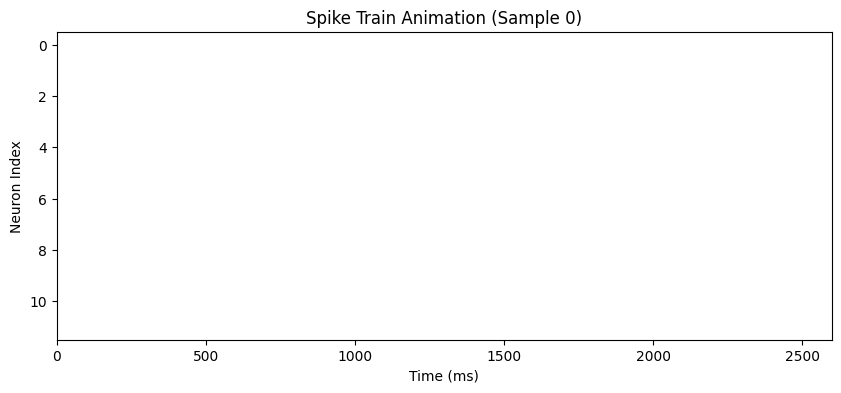

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Assume you already ran:
# X_train_np, y_train_np, train_T = prepare_spike_data(train_bytes, train_counts)

# Pick a sample to visualize
sample_index = 0  # you can change this to see other samples
spike_matrix = X_train_np[sample_index]  # shape: (12, Tmax * 100)
num_neurons, total_time = spike_matrix.shape

# Animation setup
fig, ax = plt.subplots(figsize=(10, 4))
im = ax.imshow(np.zeros((num_neurons, 1)), cmap='gray', aspect='auto', vmin=0, vmax=1)
ax.set_title(f"Spike Train Animation (Sample {sample_index})")
ax.set_xlabel("Time (ms)")
ax.set_ylabel("Neuron Index")

# Update function for animation
def update(frame):
    # Show activity from t=0 to current frame
    current_spikes = spike_matrix[:, :frame+1]
    im.set_data(current_spikes)
    ax.set_xlim(0, total_time)
    ax.set_ylim(11.5, -0.5)
    return [im]

# Create animation
ani = animation.FuncAnimation(
    fig, update, frames=total_time, interval=1, blit=True, repeat=False
)

plt.show()


In [ ]:
def visualize_original_vs_latency(original_block, latency_encoded_block, title=None):
    """
    Displays side-by-side comparison of the original binarized input and latency-encoded spike output.

    Args:
        original_block (np.ndarray): Original binarized block of shape (12, T).
        latency_encoded_block (np.ndarray): Latency-encoded output of shape (12, Tmax * 100).
        title (str, optional): Plot title.
    """
    T = original_block.shape[1]
    Tmax_100 = latency_encoded_block.shape[1]

    fig, axs = plt.subplots(1, 2, figsize=(18, 5), gridspec_kw={'width_ratios': [T, Tmax_100]})

    # Left: original binary block as image
    im0 = axs[0].imshow(original_block, aspect='auto', cmap='Greys', interpolation='nearest', origin='lower')
    axs[0].set_title("Original Binarized (12, T)")
    axs[0].set_xlabel("Frame")
    axs[0].set_ylabel("Electrode Channel")
    axs[0].set_yticks(np.arange(0, 12))
    axs[0].set_yticklabels([f'Ch {i+1}' for i in range(12)])

    # Right: latency-encoded raster
    for ch in range(12):
        spike_times = np.where(latency_encoded_block[ch] > 0)[0]
        axs[1].vlines(spike_times, ch + 0.5, ch + 1.5, color='black', linewidth=0.8)
    axs[1].set_ylim(0.5, 12.5)
    axs[1].set_xlim(0, Tmax_100)
    axs[1].set_xticks(np.arange(0, Tmax_100 + 1, 100))
    axs[1].set_xlabel("Time (ms)")
    axs[1].set_yticks(np.arange(1, 13))
    axs[1].set_yticklabels([f'Ch {i}' for i in range(1, 13)])
    axs[1].set_title("Latency-Encoded Raster (12, Tmax * 100)")
    axs[1].grid(True, linestyle='--', alpha=0.3)

    if title:
        fig.suptitle(title, fontsize=16)

    plt.tight_layout()
    plt.show()

# Example for block 0
original_block = (X_raw[0].T >= np.mean(X_raw[0].T)).astype(np.float32)  # shape (12, T)
latency_block = X_np[0]  # shape (12, Tmax*100)

visualize_original_vs_latency(original_block, latency_block, title="Block 0 Comparison")

In [ ]:
# import torch

# data_tensor = torch.tensor(data_np, dtype=torch.float32)
# label_tensor = torch.tensor(labels_np, dtype=torch.long)

### Get latency encoded blocks (to tensors)

In [7]:
def prepare_spike_data(byte_data, label_counts):
    """Parses raw byte input, assigns speaker labels, pads sequences, and normalizes.

    Args:
        - byte_data (bytes): raw byte input read from ae.train, ae.test
        - label_counts (List[int]): each element represents how many blocks belong to a speaker

    Returns:
        - torch.Tensor of shape (N, 12, T): padded and normalized data
        - torch.Tensor of shape (N,): speaker labels
        - int: maximum sequence length (T)
    """
    text = byte_data.decode("utf-8")
    blocks = [b.strip() for b in text.strip().split("\n\n") if b.strip()]

    data_blocks = []
    labels = []

    for speaker_id, count in enumerate(label_counts, start=1):
        for idx in range(count):
            lines = blocks[idx].splitlines()
            frame_data = [list(map(float, line.strip().split())) for line in lines]
            data_blocks.append(np.array(frame_data))  # shape (Ti, 12)
            labels.append(speaker_id)

    latency_encoded_blocks = []
    Tmax = max([block.shape[0] for block in data_blocks])  # maximum time steps

    for block in data_blocks:
        block = block.T  # shape (12, T)
        avg = np.mean(block)
        binary_block = (block >= avg).astype(np.float32)  # binarized (12, T)

        # Split into T (12, 1) columns
        T = binary_block.shape[1]
        columns = [binary_block[:, t].reshape(12, 1) for t in range(T)]

        # Norm-based latency mapping
        norms = np.array([np.linalg.norm(col) for col in columns])
        min_norm, max_norm = norms.min(), norms.max()

        # Prevent division by zero if all norms are the same
        if max_norm - min_norm == 0:
            norm_scaled = np.zeros_like(norms)
        else:
            norm_scaled = ((norms - min_norm) / (max_norm - min_norm)) * 50.0
        norm_scaled = norm_scaled.astype(int)  # map to [0, 50]ms

        # Create output matrix of shape (12, Tmax * 100)
        stim_length = Tmax * 100  # 100ms per time slot
        output_matrix = np.zeros((12, stim_length), dtype=np.float32)

        for i, col in enumerate(columns):
            t_offset = i * 100 + norm_scaled[i]  # place within 100ms window
            if t_offset < stim_length:
                output_matrix[:, t_offset] = col.flatten()

        latency_encoded_blocks.append(output_matrix)

    # Stack all (12, Tmax*100) into a tensor of shape (N, 12, Tmax*100)
    data_tensor = torch.tensor(np.stack(latency_encoded_blocks), dtype=torch.float32)
    label_tensor = torch.tensor(labels, dtype=torch.long)

    return data_tensor, label_tensor, Tmax


In [ ]:
# plt.imshow(latency_encoded_blocks[0], aspect='auto', cmap='gray_r')
# plt.xlabel('Time (ms)')
# plt.ylabel('Channels')
# plt.title('Latency-encoded Spike Matrix')
# plt.colorbar()
# plt.show()

In [18]:
X_train, y_train, train_T = prepare_spike_data(train_bytes, train_counts)
X_test, y_test, test_T = prepare_spike_data(test_bytes, test_counts)

print(X_train.shape)  # (270, 12, train_T)
print(y_train.shape)  # (270,)
print(X_test.shape)  # (370, 12, test_T)
print(y_test.shape)  # (270,)
print(train_T) # 26
print(test_T) # 29

torch.Size([270, 12, 2600])
torch.Size([270])
torch.Size([370, 12, 2900])
torch.Size([370])
26
29


In [8]:
# Choose sample index (e.g., 0)
sample_idx = 0
spike_block = X_train[sample_idx].numpy()  # shape (12, Tmax*100)

plt.figure(figsize=(15, 5))
plt.imshow(spike_block, cmap='gray_r', aspect='auto')
plt.xlabel('Time (ms)')
plt.ylabel('Channel')
plt.title(f'Spike Train for Sample {sample_idx}, Label = Speaker {y_train[sample_idx].item()}')
plt.colorbar(label='Spike (0 or 1)')
plt.show()


NameError: name 'X_train' is not defined

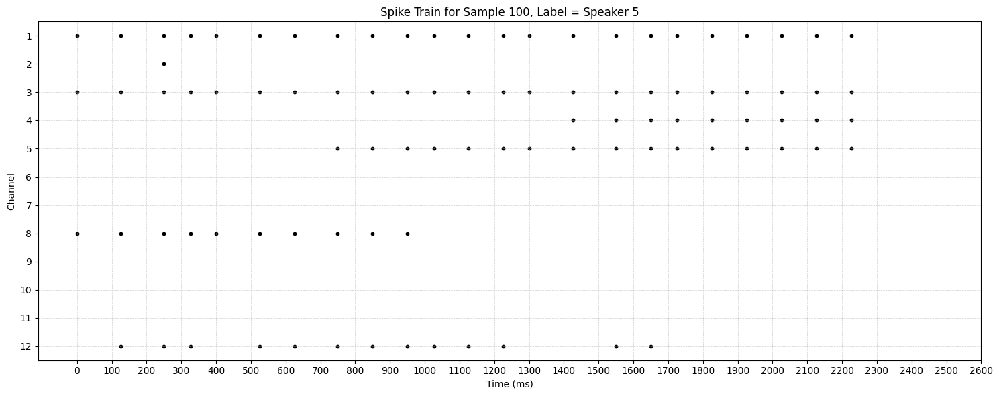

In [17]:
# Choose sample index
sample_idx = 100
spike_block = X_train[sample_idx].numpy()  # shape: (12, Tmax*100)
channels, time_steps = spike_block.shape

# Get coordinates of spikes
y_coords, x_coords = np.where(spike_block == 1)

# Plot
plt.figure(figsize=(15, 6))
plt.scatter(x_coords, y_coords + 1, c='black', s=10, marker='o')  # +1 to label channels as 1–12

# Y-axis: channel numbers from 1 to 12, with 1 at the top
plt.yticks(ticks=np.arange(1, channels + 1), labels=np.arange(1, channels + 1))
plt.ylim(0.5, channels + 0.5)
plt.gca().invert_yaxis()  # <- Invert Y-axis so channel 1 is at top

# X-axis: ticks every 100 ms
tick_spacing = 100
x_ticks = np.arange(0, time_steps + 1, tick_spacing)
plt.xticks(ticks=x_ticks)
plt.xlabel('Time (ms)')
plt.ylabel('Channel')
plt.title(f'Spike Train for Sample {sample_idx}, Label = Speaker {y_train[sample_idx].item() + 1}')

# Grid lines
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)

plt.tight_layout()
plt.show()


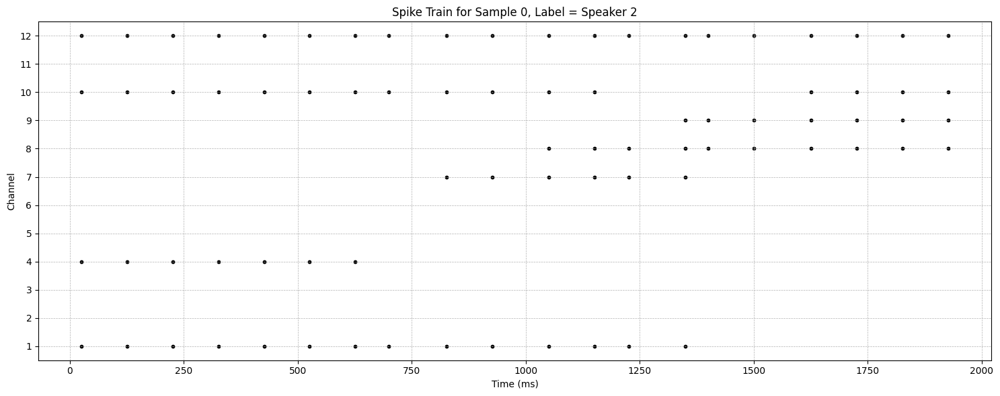

In [13]:
import matplotlib.pyplot as plt
import numpy as np

# Choose sample index
sample_idx = 0
spike_block = X_train[sample_idx].numpy()  # shape: (12, Tmax*100)
channels, time_steps = spike_block.shape

# Get (x, y) coordinates for spikes (value == 1)
y_coords, x_coords = np.where(spike_block == 1)

# Flip y-axis so that channel 1 is at the bottom
y_coords = channels - y_coords

# Plot
plt.figure(figsize=(15, 6))
plt.scatter(x_coords, y_coords, c='black', s=10, marker='o')

# Channel labels from 1 to 12 (bottom to top)
plt.yticks(ticks=np.arange(1, channels + 1), labels=np.arange(1, channels + 1))
plt.ylim(0.5, channels + 0.5)

plt.xlabel('Time (ms)')
plt.ylabel('Channel')
plt.title(f'Spike Train for Sample {sample_idx}, Label = Speaker {y_train[sample_idx].item() + 1}')  # +1 if you subtracted 1 for labels
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()
